In [1]:
!pip install h5py numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 7.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 44.5 MB/s eta 0:00:00 0:00:01

[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [ ]:
import h5py
import csv
import numpy as np
import glob

 
def main(inp_name): 
    '''
        This function gets a string (name of output files) as input, generates two files:
        "input_name.hdf5" and "input_name.csv" and write the contents of all chunk?.hdf5 
        files in the same directory into them. 
    '''
    output_merge = inp_name+'.hdf5'
    HDF0 = h5py.File(output_merge, 'a')
    HDF0.create_group("data")
     
    csvfile = open(output_merge.split('.')[0]+'.csv', 'w')          
    output_writer = csv.writer(csvfile, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
    output_writer.writerow(['network_code','receiver_code','receiver_type','receiver_latitude','receiver_longitude',
                                 'receiver_elevation_m','p_arrival_sample','p_status','p_weight','p_travel_sec', 
                                 's_arrival_sample','s_status','s_weight',
                                 'source_id','source_origin_time','source_origin_uncertainty_sec', 
                                 'source_latitude','source_longitude','source_error_sec',
                                 'source_gap_deg','source_horizontal_uncertainty_km', 'source_depth_km', 'source_depth_uncertainty_km',
                                 'source_magnitude', 'source_magnitude_type', 'source_magnitude_author','source_mechanism_strike_dip_rake',
                                 'source_distance_deg', 'source_distance_km', 'back_azimuth_deg', 'snr_db', 'coda_end_sample', 
                                 'trace_start_time', 'trace_category', 'trace_name'])
    csvfile.flush()
    print('output files have been generated!')
    
    for h5name in glob.glob('datasets/chunk*.hdf5'):
        print('working on '+h5name+'...')
        dtfl = h5py.File(h5name, 'r') 
        for evi in dtfl['data']:
            print(evi)
            x = dtfl.get('data/'+str(evi)) 
            data = np.array(x)
                   
            HDFr = h5py.File(output_merge, 'a')
            dsF = HDFr.create_dataset("data/"+evi, data.shape, data=data, dtype=np.float32) 
             
            dsF.attrs['network_code'] = x.attrs['network_code']
            dsF.attrs['receiver_code'] = x.attrs['receiver_code']
            dsF.attrs['receiver_type'] = x.attrs['receiver_type']
            dsF.attrs['receiver_latitude'] = x.attrs['receiver_latitude']
            dsF.attrs['receiver_longitude'] = x.attrs['receiver_longitude']
            dsF.attrs['receiver_elevation_m'] = x.attrs['receiver_elevation_m']
            dsF.attrs['p_arrival_sample'] = x.attrs['p_arrival_sample']
            dsF.attrs['p_status'] = x.attrs['p_status']
            dsF.attrs['p_weight'] = x.attrs['p_weight']
            dsF.attrs['p_travel_sec'] = x.attrs['p_travel_sec']
            dsF.attrs['s_arrival_sample'] = x.attrs['s_arrival_sample']
            dsF.attrs['s_status'] = x.attrs['s_status']
            dsF.attrs['s_weight'] = x.attrs['s_weight']
            dsF.attrs['source_id'] = x.attrs['source_id']
            dsF.attrs['source_origin_time'] = x.attrs['source_origin_time']
            dsF.attrs['source_origin_uncertainty_sec'] = x.attrs['source_origin_uncertainty_sec']
            dsF.attrs['source_latitude'] = x.attrs['source_latitude']
            dsF.attrs['source_longitude'] = x.attrs['source_longitude']
            dsF.attrs['source_error_sec'] = x.attrs['source_error_sec']
            dsF.attrs['source_gap_deg'] = x.attrs['source_gap_deg']
            dsF.attrs['source_horizontal_uncertainty_km'] = x.attrs['source_horizontal_uncertainty_km']
            dsF.attrs['source_depth_km'] = x.attrs['source_depth_km']
            dsF.attrs['source_depth_uncertainty_km'] = x.attrs['source_depth_uncertainty_km']
            dsF.attrs['source_magnitude'] = x.attrs['source_magnitude']
            dsF.attrs['source_magnitude_type'] = x.attrs['source_magnitude_type']
            dsF.attrs['source_magnitude_author'] = x.attrs['source_magnitude_author']
            dsF.attrs['source_mechanism_strike_dip_rake'] = x.attrs['source_mechanism_strike_dip_rake']
            dsF.attrs['source_distance_deg'] = x.attrs['source_distance_deg']
            dsF.attrs['source_distance_km'] = x.attrs['source_distance_km']
            dsF.attrs['back_azimuth_deg'] = x.attrs['back_azimuth_deg']
            dsF.attrs['snr_db'] = x.attrs['snr_db']
            dsF.attrs['coda_end_sample'] = x.attrs['coda_end_sample']
            dsF.attrs['trace_start_time'] = x.attrs['trace_start_time'] 
            dsF.attrs['trace_category'] = x.attrs['trace_category'] 
            dsF.attrs['trace_name'] = x.attrs['trace_name']  
            HDFr.flush() 
           
             
            output_writer.writerow([x.attrs['network_code'], 
                                    x.attrs['receiver_code'], 
                                    x.attrs['receiver_type'],
                                    x.attrs['receiver_latitude'], 
                                    x.attrs['receiver_longitude'], 
                                    x.attrs['receiver_elevation_m'], 
                                    x.attrs['p_arrival_sample'], 
                                    x.attrs['p_status'],
                                    x.attrs['p_weight'], 
                                    x.attrs['p_travel_sec'], 
                                    x.attrs['s_arrival_sample'],
                                    x.attrs['s_status'], 
                                    x.attrs['s_weight'],
                                    x.attrs['source_id'], 
                                    x.attrs['source_origin_time'], 
                                    x.attrs['source_origin_uncertainty_sec'], 
                                    x.attrs['source_latitude'],
                                    x.attrs['source_longitude'],
                                    x.attrs['source_error_sec'], 
                                    x.attrs['source_gap_deg'],
                                    x.attrs['source_horizontal_uncertainty_km'],   
                                    x.attrs['source_depth_km'],
                                    x.attrs['source_depth_uncertainty_km'],
                                    x.attrs['source_magnitude'], 
                                    x.attrs['source_magnitude_type'], 
                                    x.attrs['source_magnitude_author'], 
                                    x.attrs['source_mechanism_strike_dip_rake'],
                                    x.attrs['source_distance_deg'],
                                    x.attrs['source_distance_km'],
                                    x.attrs['back_azimuth_deg'],
                                    x.attrs['snr_db'], 
                                    x.attrs['coda_end_sample'], 
                                    x.attrs['trace_start_time'], 
                                    x.attrs['trace_category'], 
                                    x.attrs['trace_name']]);            
            csvfile.flush()        
            HDFr.close()    
                
        
if __name__ == '__main__':
   
    inp_name="merged"    
    main(inp_name)    

output files have been generated!
working on datasets/chunk2.hdf5...
109C.TA_20060723155859_EV
109C.TA_20061103155652_EV
109C.TA_20061103161223_EV
109C.TA_20061114133221_EV
109C.TA_20061127104640_EV
109C.TA_20061129121745_EV
109C.TA_20061129211102_EV
109C.TA_20061129211301_EV
109C.TA_20061129221547_EV
109C.TA_20070109140205_EV
109C.TA_20070117160753_EV
109C.TA_20070209033349_EV
109C.TA_20070226181833_EV
109C.TA_20070301143752_EV
109C.TA_20070306033340_EV
109C.TA_20070415225732_EV
109C.TA_20070416034531_EV
109C.TA_20070418093344_EV
109C.TA_20070418222316_EV
109C.TA_20070419113340_EV
109C.TA_20070419120129_EV
109C.TA_20070525113536_EV
109C.TA_20070525114806_EV
109C.TA_20070608061311_EV
109C.TA_20070609212927_EV
109C.TA_20070610114701_EV
109C.TA_20070610115123_EV
109C.TA_20070610234242_EV
109C.TA_20070612100856_EV
109C.TA_20070613030646_EV
109C.TA_20070616163138_EV
109C.TA_20070617203107_EV
109C.TA_20070623050227_EV
109C.TA_20070627010414_EV
109C.TA_20070628195508_EV
109C.TA_2007063018244

In [ ]:
import torch
from torch.utils.data import Dataset
import h5py
import numpy as np

class STEADDataset(Dataset):
    def __init__(self, hdf5_path, transform=None):
        self.hdf5_path = hdf5_path
        self.transform = transform

        # Load event IDs during init
        with h5py.File(hdf5_path, 'r') as f:
            self.event_ids = list(f['data'].keys())

    def __len__(self):
        return len(self.event_ids)

    def __getitem__(self, idx):
        event_id = self.event_ids[idx]
        
        with h5py.File(self.hdf5_path, 'r') as f:
            trace = f['data'][event_id][()]  # shape: (6000, 3)

        # Normalize
        trace = (trace - np.mean(trace, axis=0)) / np.std(trace, axis=0)

        if self.transform:
            trace = self.transform(trace)

        trace_tensor = torch.tensor(trace, dtype=torch.float32)

        return trace_tensor, event_id  

In [2]:
from torch.utils.data import DataLoader

dataset = STEADDataset("merged.hdf5")
loader = DataLoader(dataset, batch_size=32, shuffle=True, num_workers=0)


In [3]:
import pandas as pd

def load_label_dict(csv_path):
    df = pd.read_csv(csv_path)
    label_dict = dict(zip(df['event_id'], df['label']))
    return label_dict


In [4]:
class STEADDataset(Dataset):
    def __init__(self, hdf5_path, label_dict, transform=None):
        self.hdf5_path = hdf5_path
        self.transform = transform
        self.label_dict = label_dict

        with h5py.File(hdf5_path, 'r') as f:
            self.event_ids = [eid for eid in f['data'].keys() if eid in label_dict]

    def __len__(self):
        return len(self.event_ids)

    def __getitem__(self, idx):
        event_id = self.event_ids[idx]

        with h5py.File(self.hdf5_path, 'r') as f:
            trace = f['data'][event_id][()]  # (6000, 3)

        trace = (trace - np.mean(trace, axis=0)) / np.std(trace, axis=0)
        if self.transform:
            trace = self.transform(trace)

        trace_tensor = torch.tensor(trace, dtype=torch.float32)
        label_tensor = torch.tensor(self.label_dict[event_id], dtype=torch.long)

        return trace_tensor, label_tensor


In [ ]:
# 1. Load labels from CSV
label_dict = load_label_dict("merged.csv")  

# 2. Create dataset and loader
dataset = STEADDataset("merged.hdf5", label_dict)
loader = DataLoader(dataset, batch_size=32, shuffle=True)


In [6]:
import pandas as pd


df = pd.read_csv("merged.csv", low_memory=False)

print(df.columns)


Index(['network_code', 'receiver_code', 'receiver_type', 'receiver_latitude',
       'receiver_longitude', 'receiver_elevation_m', 'p_arrival_sample',
       'p_status', 'p_weight', 'p_travel_sec', 's_arrival_sample', 's_status',
       's_weight', 'source_id', 'source_origin_time',
       'source_origin_uncertainty_sec', 'source_latitude', 'source_longitude',
       'source_error_sec', 'source_gap_deg',
       'source_horizontal_uncertainty_km', 'source_depth_km',
       'source_depth_uncertainty_km', 'source_magnitude',
       'source_magnitude_type', 'source_magnitude_author',
       'source_mechanism_strike_dip_rake', 'source_distance_deg',
       'source_distance_km', 'back_azimuth_deg', 'snr_db', 'coda_end_sample',
       'trace_start_time', 'trace_category', 'trace_name'],
      dtype='object')


In [7]:
print(df['trace_name'].head())


0    109C.TA_20060723155859_EV
1    109C.TA_20061103155652_EV
2    109C.TA_20061103161223_EV
3    109C.TA_20061114133221_EV
4    109C.TA_20061127104640_EV
Name: trace_name, dtype: object


In [8]:
label_dict = dict(zip(df['trace_name'], df['trace_category']))


In [9]:
import pandas as pd

def load_label_dict(csv_path):
    df = pd.read_csv(csv_path, low_memory=False)
    label_dict = dict(zip(df['trace_name'], df['trace_category']))  # <-- You can swap with another label column
    return label_dict


In [11]:
import torch
from torch.utils.data import Dataset
import h5py
import numpy as np

class STEADDataset(Dataset):
    def __init__(self, hdf5_path, label_dict, transform=None):
        self.hdf5_path = hdf5_path
        self.label_dict = label_dict
        self.transform = transform
        self.valid_keys = []

        # Open HDF5 once to collect valid keys (those with labels)
        with h5py.File(hdf5_path, 'r') as f:
            for key in f['data'].keys():
                if key in label_dict:
                    self.valid_keys.append(key)

    def __len__(self):
        return len(self.valid_keys)

    def __getitem__(self, idx):
        key = self.valid_keys[idx]
        with h5py.File(self.hdf5_path, 'r') as f:
            waveform = f['data'][key][()]  # shape (6000, 3)
        
        label = self.label_dict[key]

        # Encode label to integer (optional)
        label_tensor = torch.tensor(0 if label == 'earthquake' else 1, dtype=torch.long)

        if self.transform:
            waveform = self.transform(waveform)

        # Convert waveform to tensor
        waveform_tensor = torch.tensor(waveform, dtype=torch.float32)

        return waveform_tensor, label_tensor


In [12]:
from torch.utils.data import DataLoader

label_dict = load_label_dict("merged.csv")
dataset = STEADDataset("merged.hdf5", label_dict)

dataloader = DataLoader(dataset, batch_size=32, shuffle=True)


In [13]:
for batch_x, batch_y in dataloader:
    print("Batch shape:", batch_x.shape)
    print("Labels:", batch_y)
    break


Batch shape: torch.Size([32, 6000, 3])
Labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1])


In [14]:
def normalize(waveform):
    return (waveform - np.mean(waveform)) / (np.std(waveform) + 1e-6)


In [15]:
dataset = STEADDataset("merged.hdf5", label_dict, transform=normalize)


In [22]:
import torch
import torch.nn as nn

class VGG1DSeismic(nn.Module):
    def __init__(self, input_length=6000, num_classes=2):
        super(VGG1DSeismic, self).__init__()

        self.features = nn.Sequential(
            # Block 1
            nn.Conv1d(3, 64, kernel_size=3, padding=1),
            nn.BatchNorm1d(64),
            nn.ReLU(inplace=True),
            nn.Conv1d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm1d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool1d(kernel_size=2, stride=2),  # → length // 2

            # Block 2
            nn.Conv1d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm1d(128),
            nn.ReLU(inplace=True),
            nn.Conv1d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm1d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool1d(kernel_size=2, stride=2),  # → length // 4

            # Block 3
            nn.Conv1d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm1d(256),
            nn.ReLU(inplace=True),
            nn.Conv1d(256, 256, kernel_size=3, padding=1),
            nn.BatchNorm1d(256),
            nn.ReLU(inplace=True),
            nn.MaxPool1d(kernel_size=2, stride=2),  # → length // 8
        )

        reduced_length = input_length // 8  # 6000 → 750
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(256 * reduced_length, 512),
            nn.ReLU(True),
            nn.Dropout(0.5),
            nn.Linear(512, 128),
            nn.ReLU(True),
            nn.Dropout(0.3),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        x = x.permute(0, 2, 1)  # (B, 6000, 3) → (B, 3, 6000)
        x = self.features(x)
        x = self.classifier(x)
        return x


In [18]:
model = VGG1DSeismic(num_classes=2)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)


In [ ]:
def __getitem__(self, idx):
    
    return torch.tensor(trace, dtype=torch.float32), torch.tensor(label, dtype=torch.long)


In [ ]:
from torch.utils.data import DataLoader, random_split


train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_ds, val_ds = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_ds, batch_size=32, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=32, shuffle=False)


In [25]:
def train(model, train_loader, val_loader, criterion, optimizer, epochs=10, device="cuda"):
    model.to(device)

    for epoch in range(epochs):
        model.train()
        total_loss, correct, total = 0, 0, 0

        for X, y in train_loader:
            X, y = X.to(device), y.to(device)

            optimizer.zero_grad()
            outputs = model(X)
            loss = criterion(outputs, y)
            loss.backward()
            optimizer.step()

            total_loss += loss.item() * X.size(0)
            preds = outputs.argmax(dim=1)
            correct += (preds == y).sum().item()
            total += y.size(0)

        train_acc = 100 * correct / total
        val_acc = evaluate(model, val_loader, device)

        print(f"Epoch {epoch+1} | Loss: {total_loss/total:.4f} | Train Acc: {train_acc:.2f}% | Val Acc: {val_acc:.2f}%")


In [32]:
def evaluate(model, val_loader, device="cuda"):
    model.eval()
    correct, total = 0, 0

    with torch.no_grad():
        for X, y in val_loader:
            X, y = X.to(device), y.to(device)
            outputs = model(X)
            preds = outputs.argmax(dim=1)
            correct += (preds == y).sum().item()
            total += y.size(0)
    
    return 100 * correct / total


In [16]:
from torch.utils.data import random_split
generator = torch.Generator().manual_seed(42)  # for reproducibility
train_ds, val_ds = random_split(dataset, [train_size, val_size], generator=generator)


In [ ]:
print(np.unique([y for _, y in dataset], return_counts=True))


In [31]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from sklearn.metrics import accuracy_score
import numpy as np
from tqdm import tqdm

# === Optional: early stopping ===
class EarlyStopping:
    def __init__(self, patience=5, verbose=False):
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.verbose = verbose

    def __call__(self, val_loss, model):
        score = -val_loss
        if self.best_score is None or score > self.best_score:
            self.best_score = score
            self.counter = 0
        else:
            self.counter += 1
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter} / {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True

# === Training + Validation Function ===
def train_model(model, train_loader, val_loader, num_epochs=25, lr=1e-3, patience=7):
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

    early_stopping = EarlyStopping(patience=patience, verbose=True)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        all_preds, all_labels = [], []

        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]"):
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            preds = torch.argmax(outputs, dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

        train_acc = accuracy_score(all_labels, all_preds)
        val_loss, val_acc = evaluate_model(model, val_loader, criterion, device)

        print(f"Epoch {epoch+1} | Loss: {running_loss:.4f} | Train Acc: {train_acc*100:.2f}% | Val Loss: {val_loss:.4f} | Val Acc: {val_acc*100:.2f}%")

        scheduler.step()
        early_stopping(val_loss, model)
        if early_stopping.early_stop:
            print("Early stopping triggered.")
            break

    print("Training complete.")
    torch.save(model.state_dict(), "model.pt")

# === Evaluation Function ===
def evaluate_model(model, loader, criterion, device):
    model.eval()
    val_loss = 0.0
    all_preds, all_labels = [], []

    with torch.no_grad():
        for inputs, labels in loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            val_loss += loss.item()
            preds = torch.argmax(outputs, dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    acc = accuracy_score(all_labels, all_preds)
    return val_loss / len(loader), acc



In [24]:
!pip install tqdm


[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [32]:
model = VGG1DSeismic(input_length=6000, num_classes=2)
dummy_input = torch.randn(8, 6000, 3)
out = model(dummy_input)
print(out.shape)  # should be [8, 2]


torch.Size([8, 2])


In [35]:
def fine_tune_vgg(model, freeze_until='block2', lr_base=1e-4, lr_new=1e-3):
    """
    Freeze layers up to a certain block and apply differential learning rates.
    
    Args:
        model: your VGG1DSeismic model.
        freeze_until: one of ['none', 'block1', 'block2', 'all'].
        lr_base: learning rate for frozen/older layers (usually lower).
        lr_new: learning rate for newly added layers (usually higher).
    
    Returns:
        optimizer ready with parameter groups.
    """

    # Helper: get named children as list
    def get_blocks(seq):
        return list(seq.children())

    # Freeze logic
    blocks = get_blocks(model.features)
    freeze_map = {
        'none': [],
        'block1': blocks[:2],      # Conv64 + BN + Conv64 + BN + ReLU
        'block2': blocks[:5],      # Up to Conv128
        'all': blocks              # Freeze everything in features
    }

    if freeze_until not in freeze_map:
        raise ValueError(f"Invalid freeze_until: {freeze_until}. Choose from {list(freeze_map.keys())}")

    for block in freeze_map[freeze_until]:
        for param in block.parameters():
            param.requires_grad = False

    # Separate parameter groups
    base_params = [p for p in model.features.parameters() if p.requires_grad]
    new_params = list(model.classifier.parameters())

    # Optimizer with two learning rates
    optimizer = torch.optim.Adam([
        {'params': base_params, 'lr': lr_base},
        {'params': new_params, 'lr': lr_new}
    ])

    return optimizer


In [40]:
model = VGG1DSeismic()
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)


In [42]:
!pip install torchsummary


[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [44]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [45]:
model = VGG1DSeismic().to(device)


In [46]:
for batch_x, batch_y in dataloader:
    batch_x = batch_x.to(device)
    batch_y = batch_y.to(device)

    outputs = model(batch_x)
    loss = criterion(outputs, batch_y)


In [ ]:
# 1. Zero the gradients
optimizer.zero_grad()

# 2. Backpropagate the loss
loss.backward()

# 3. Update the weights
optimizer.step()

# 4. (Optional but smart) Track metrics
running_loss += loss.item()

# 5. (Optional) Print/log if needed


In [55]:
class STEADDataset(Dataset):
    def __init__(self, hdf5_path, label_dict, transform=None):
        self.hdf5_path = hdf5_path
        self.label_dict = label_dict
        self.transform = transform

        with h5py.File(hdf5_path, 'r') as f:
            self.event_ids = list(f['data'].keys())

    def __len__(self):
        return len(self.event_ids)

    def __getitem__(self, idx):
        event_id = self.event_ids[idx]

        with h5py.File(self.hdf5_path, 'r') as f:
            trace = f['data'][event_id][()]  # (6000, 3)

        trace = (trace - np.mean(trace, axis=0)) / np.std(trace, axis=0)

        if self.transform:
            trace = self.transform(trace)

        trace_tensor = torch.tensor(trace, dtype=torch.float32)

        label = self.label_dict.get(event_id, -1)
        label_tensor = torch.tensor(label, dtype=torch.long)

        return trace_tensor, label_tensor


In [ ]:
def load_label_dict(csv_path):
    df = pd.read_csv(csv_path, low_memory=False)  
    df.columns = df.columns.str.strip().str.lower()  

    label_map = {'earthquake': 0, 'noise': 1}  
    df['label'] = df['trace_category'].map(label_map)

    return dict(zip(df['trace_name'], df['label']))


In [ ]:
label_dict = load_label_dict("merged.csv")

train_dataset = STEADDataset("merged.hdf5", label_dict, transform=None)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)


In [52]:
import pandas as pd

df = pd.read_csv("merged.csv")
print("Columns in merged.csv:", df.columns.tolist())


/tmp/ipykernel_636/1645594023.py:3: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("merged.csv")


Columns in merged.csv: ['network_code', 'receiver_code', 'receiver_type', 'receiver_latitude', 'receiver_longitude', 'receiver_elevation_m', 'p_arrival_sample', 'p_status', 'p_weight', 'p_travel_sec', 's_arrival_sample', 's_status', 's_weight', 'source_id', 'source_origin_time', 'source_origin_uncertainty_sec', 'source_latitude', 'source_longitude', 'source_error_sec', 'source_gap_deg', 'source_horizontal_uncertainty_km', 'source_depth_km', 'source_depth_uncertainty_km', 'source_magnitude', 'source_magnitude_type', 'source_magnitude_author', 'source_mechanism_strike_dip_rake', 'source_distance_deg', 'source_distance_km', 'back_azimuth_deg', 'snr_db', 'coda_end_sample', 'trace_start_time', 'trace_category', 'trace_name']


In [56]:
label_dict = load_label_dict("merged.csv")
dataset = STEADDataset("merged.hdf5", label_dict)


In [ ]:
label = self.label_dict.get(event_id, -1)
if not isinstance(label, (int, np.integer)):
    print(f"[BAD LABEL] {event_id=} | {label=} | type={type(label)}")
label_tensor = torch.tensor(label, dtype=torch.long)


In [ ]:

df['trace_category'] = df['trace_category'].str.lower().str.strip()

df['trace_category'] = df['trace_category'].replace({
    'earthquake_local': 'earthquake',
    'earthquake_tele': 'earthquake',
    'earthquake_explosion': 'earthquake',  # in case it exists
    'noise_explosion': 'noise',
    'noise_rain': 'noise',
    'unknown': 'noise'  # optional
})


In [62]:
df = df[df['trace_category'].isin(['earthquake', 'noise'])].copy()


In [63]:
label_dict = {
    row['trace_name']: 1 if row['trace_category'] == 'earthquake' else 0
    for _, row in df.iterrows()
}


In [ ]:
# Assuming 'trace_category' is a column in your dataframe that contains categories like "earthquake_local", "noise", etc.

label_dict = {
    'earthquake_local': 1,
    'earthquake_tele': 2,
    'earthquake_explosion': 3,
    'noise': 0,
}

def __getitem__(self, idx):
    event_id = self.df.iloc[idx]['event_id']
    label = self.df.iloc[idx]['trace_category']
    label = label_dict.get(label.lower(), -1) 
    if label == -1:
        print(f"Invalid or missing label for event_id: {event_id} -> {label}")
    label_tensor = torch.tensor(label, dtype=torch.long)
    return trace_tensor, label_tensor


In [ ]:
invalid_labels = []
for label in df['trace_category']:  
    if label_dict.get(label.lower(), -1) == -1:
        invalid_labels.append(label)

if invalid_labels:
    print(f"Invalid categories found: {invalid_labels}")
else:
    print("All categories are valid!")


Invalid categories found: ['earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthquake', 'earthq

In [85]:
label_dict = {
    'earthquake': 1,
    'noise': 0
}


In [86]:
invalid_labels = []
for label in df['trace_category']:
    cleaned_label = label.strip().lower()  # Normalize the label
    if label_dict.get(cleaned_label, -1) == -1:
        invalid_labels.append(cleaned_label)

if invalid_labels:
    print(f"Invalid categories found: {invalid_labels}")
else:
    print("All categories are valid!")


All categories are valid!


In [87]:
class STEADDataset(torch.utils.data.Dataset):
    def __init__(self, dataframe, label_dict):
        self.df = dataframe
        self.label_dict = label_dict

    def __getitem__(self, idx):
        # Retrieve trace category
        trace_category = self.df.iloc[idx]['trace_category'].strip().lower()  # Normalize to avoid issues
        label = self.label_dict.get(trace_category, -1)  # Retrieve label from dictionary
        
        # Safeguard for invalid categories (though we've already validated them)
        if label == -1:
            raise ValueError(f"Invalid or missing label for category: {trace_category}")

        # Retrieve data (e.g., trace data or features) for this idx
        trace_data = self.df.iloc[idx]['trace_data']  # Adjust as necessary for your data column
        trace_tensor = torch.tensor(trace_data, dtype=torch.float32)  # Convert to tensor
        
        return trace_tensor, label


In [88]:
def train(model, dataloader, optimizer, criterion, device):
    model.train()  # Set model to training mode
    for batch_x, batch_y in dataloader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        
        optimizer.zero_grad()  # Reset gradients
        
        # Forward pass
        outputs = model(batch_x)
        loss = criterion(outputs, batch_y)
        
        # Backward pass
        loss.backward()
        
        # Update weights
        optimizer.step()
        
        # You can add accuracy calculation here if needed
        # For now, we just print loss
        print(f"Loss: {loss.item()}")

def main():
    # Initialize model, criterion, optimizer
    model = YourModel()
    criterion = torch.nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
    
    # Create the dataloader from your dataset
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=32, shuffle=True)

    # Start the training loop
    train(model, dataloader, optimizer, criterion, device='cuda' if torch.cuda.is_available() else 'cpu')


In [89]:
def train(model, dataloader, optimizer, criterion, device):
    model.train()  # Set model to training mode
    correct = 0
    total = 0
    for batch_x, batch_y in dataloader:
        batch_x, batch_y = batch_x.to(device), batch_y.to(device)
        
        optimizer.zero_grad()  # Reset gradients
        
        # Forward pass
        outputs = model(batch_x)
        loss = criterion(outputs, batch_y)
        
        # Backward pass
        loss.backward()
        
        # Update weights
        optimizer.step()

        # Track accuracy
        _, predicted = torch.max(outputs, 1)
        total += batch_y.size(0)
        correct += (predicted == batch_y).sum().item()

    accuracy = 100 * correct / total
    print(f"Training Loss: {loss.item()}, Accuracy: {accuracy}%")


In [90]:
def validate(model, dataloader, criterion, device):
    model.eval()  # Set model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():  # No need to calculate gradients during validation
        for batch_x, batch_y in dataloader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)
            
            # Forward pass
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            
            # Track accuracy
            _, predicted = torch.max(outputs, 1)
            total += batch_y.size(0)
            correct += (predicted == batch_y).sum().item()

    accuracy = 100 * correct / total
    print(f"Validation Loss: {loss.item()}, Accuracy: {accuracy}%")


In [92]:
import torch
import torch.nn as nn

class VGG16(nn.Module):
    def __init__(self, num_classes=1000):
        super(VGG16, self).__init__()
        
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        
        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(4096, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)  # Flatten the tensor
        x = self.classifier(x)
        return x


In [ ]:
import torch.optim as optim
from torch.utils.data import DataLoader

# Define training loop
def train(model, dataloader, optimizer, criterion, device, num_epochs=10):
    model.to(device)  # Move the model to the device
    model.train()  # Set model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        correct = 0
        total = 0
        for batch_x, batch_y in dataloader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)
            
            optimizer.zero_grad()  # Zero the gradients
            
            # Forward pass
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            
            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            # Calculate accuracy
            _, predicted = torch.max(outputs, 1)
            total += batch_y.size(0)
            correct += (predicted == batch_y).sum().item()

            running_loss += loss.item()

        accuracy = 100 * correct / total
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(dataloader):.4f}, Accuracy: {accuracy:.2f}%")

# Define validation loop
def validate(model, dataloader, criterion, device):
    model.eval()  # Set model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():  # No need to compute gradients during validation
        for batch_x, batch_y in dataloader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            
            # Calculate accuracy
            _, predicted = torch.max(outputs, 1)
            total += batch_y.size(0)
            correct += (predicted == batch_y).sum().item()

    accuracy = 100 * correct / total
    print(f"Validation Loss: {loss.item():.4f}, Accuracy: {accuracy:.2f}%")
    
# Main code to set up the model, optimizer, and training loop
def main():
    # Initialize the model, loss function, and optimizer
    model = VGG16(num_classes=1000)  # Adjust number of classes for your task
    criterion = nn.CrossEntropyLoss()  # Suitable for multi-class classification
    optimizer = optim.Adam(model.parameters(), lr=0.001)  # Use Adam optimizer

    # Assuming you have a DataLoader setup
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Train the model
    train(model, train_loader, optimizer, criterion, device, num_epochs=10)

    # Validate the model
    validate(model, val_loader, criterion, device)

    # Save the model
    torch.save(model.state_dict(), 'vgg16_model.pth')

if __name__ == "__main__":
    main()



In [ ]:
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import torch.nn as nn
from torch import nn

# Define the VGG16 architecture here (same as in the previous response)

def train(model, dataloader, optimizer, criterion, device, num_epochs=10):
    model.to(device)  # Move the model to the device
    model.train()  # Set model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        correct = 0
        total = 0
        for batch_x, batch_y in dataloader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)
            
            optimizer.zero_grad()  # Zero the gradients
            
            # Forward pass
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            
            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            # Calculate accuracy
            _, predicted = torch.max(outputs, 1)
            total += batch_y.size(0)
            correct += (predicted == batch_y).sum().item()

            running_loss += loss.item()

        accuracy = 100 * correct / total
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(dataloader):.4f}, Accuracy: {accuracy:.2f}%")

def validate(model, dataloader, criterion, device):
    model.eval()  # Set model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():  # No need to compute gradients during validation
        for batch_x, batch_y in dataloader:
            batch_x, batch_y = batch_x.to(device), batch_y.to(device)
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            
            # Calculate accuracy
            _, predicted = torch.max(outputs, 1)
            total += batch_y.size(0)
            correct += (predicted == batch_y).sum().item()

    accuracy = 100 * correct / total
    print(f"Validation Loss: {loss.item():.4f}, Accuracy: {accuracy:.2f}%")
    
def main():
    # Initialize the model, loss function, and optimizer
    model = VGG16(num_classes=2)  # Adjust number of classes for your task (e.g., 10 for MNIST)
    criterion = nn.CrossEntropyLoss()  # Suitable for multi-class classification
    optimizer = optim.Adam(model.parameters(), lr=0.001)  # Use Adam optimizer

    # Dataset and DataLoader setup
    transform = transforms.Compose([transforms.Resize((224, 224)),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

    # Load the MNIST dataset (this is just an example; replace it with your dataset)
    train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
    val_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)

    

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Train the model
    train(model, train_loader, optimizer, criterion, device, num_epochs=10)

    # Validate the model
    validate(model, val_loader, criterion, device)

    # Save the model
    torch.save(model.state_dict(), 'vgg16_model.pth')

if __name__ == "__main__":
    main()


In [94]:
!pip install torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 17.6 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 26.6 MB/s eta 0:00:00

[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [95]:
import pandas as pd
from torch.utils.data import Dataset
from PIL import Image
from torchvision import transforms

class CSVDataset(Dataset):
    def __init__(self, csv_file, transform=None):
        self.data = pd.read_csv(csv_file)  # Load the CSV file
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name = self.data.iloc[idx, 0]  # Assuming first column is image path
        label = self.data.iloc[idx, 1]  # Assuming second column is label
        image = Image.open(img_name).convert('RGB')  # Open image in RGB mode

        if self.transform:
            image = self.transform(image)

        return image, label


In [98]:
class HDF5Dataset(Dataset):
    def __init__(self, hdf5_file, label_dict, transform=None):
        """
        hdf5_file: Path to the HDF5 file
        label_dict: Dictionary with valid labels (keys are event_ids, values are class labels)
        transform: Transformations to apply on the images
        """
        self.hdf5_file = h5py.File(hdf5_file, 'r')
        self.label_dict = label_dict
        self.transform = transform

        # List to store valid keys
        self.valid_keys = []

        # Check the dataset for valid keys based on label_dict
        with h5py.File(hdf5_file, 'r') as f:
            for key in f['data'].keys():
                if key in self.label_dict:
                    self.valid_keys.append(key)

        # Debug: Print the number of valid keys
        print(f"Found {len(self.valid_keys)} valid keys.")

        if len(self.valid_keys) == 0:
            print("No valid keys found. Please check if the label_dict and dataset keys match.")

        # Load the images and labels for valid keys
        self.images = []
        self.labels = []
        for key in self.valid_keys:
            image_data = np.array(self.hdf5_file['data'][key])  # Assuming 'data' holds the images
            label = self.label_dict[key]  # Get the corresponding label from label_dict
            self.images.append(image_data)
            self.labels.append(label)

        self.images = np.array(self.images)
        self.labels = np.array(self.labels)

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]

        # Convert image to PIL Image for consistency with transforms
        image = Image.fromarray(image.astype('uint8'))

        if self.transform:
            image = self.transform(image)

        return image, label


In [100]:
with h5py.File('merged.hdf5', 'r') as f:
    print("Keys in HDF5 file:", list(f['data'].keys()))


Keys in HDF5 file: ['109C.TA_20060723155859_EV', '109C.TA_20061103155652_EV', '109C.TA_20061103161223_EV', '109C.TA_20061114133221_EV', '109C.TA_20061127104640_EV', '109C.TA_20061129121745_EV', '109C.TA_20061129211102_EV', '109C.TA_20061129211301_EV', '109C.TA_20061129221547_EV', '109C.TA_20070109140205_EV', '109C.TA_20070117160753_EV', '109C.TA_20070209033349_EV', '109C.TA_20070226181833_EV', '109C.TA_20070301143752_EV', '109C.TA_20070306033340_EV', '109C.TA_20070415225732_EV', '109C.TA_20070416034531_EV', '109C.TA_20070418093344_EV', '109C.TA_20070418222316_EV', '109C.TA_20070419113340_EV', '109C.TA_20070419120129_EV', '109C.TA_20070525113536_EV', '109C.TA_20070525114806_EV', '109C.TA_20070608061311_EV', '109C.TA_20070609212927_EV', '109C.TA_20070610114701_EV', '109C.TA_20070610115123_EV', '109C.TA_20070610234242_EV', '109C.TA_20070612100856_EV', '109C.TA_20070613030646_EV', '109C.TA_20070616163138_EV', '109C.TA_20070617203107_EV', '109C.TA_20070623050227_EV', '109C.TA_20070627010414

In [101]:
class HDF5Dataset(Dataset):
    def __init__(self, hdf5_file, label_dict, transform=None):
        self.hdf5_file = h5py.File(hdf5_file, 'r')
        self.label_dict = label_dict
        self.transform = transform

        self.valid_keys = []

        # Find valid keys based on label_dict
        with h5py.File(hdf5_file, 'r') as f:
            for key in f['data'].keys():
                if key in self.label_dict:
                    self.valid_keys.append(key)

        if len(self.valid_keys) == 0:
            print("No valid keys found. Please check if the label_dict and dataset keys match.")
        else:
            print(f"Found {len(self.valid_keys)} valid keys in the dataset.")

        self.images = []
        self.labels = []

        for key in self.valid_keys:
            image_data = np.array(self.hdf5_file['data'][key])  # Assuming 'data' holds the images
            label = self.label_dict[key]  # Get the corresponding label from label_dict
            self.images.append(image_data)
            self.labels.append(label)

        self.images = np.array(self.images)
        self.labels = np.array(self.labels)

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]
        image = Image.fromarray(image.astype('uint8'))

        if self.transform:
            image = self.transform(image)

        return image, label


In [24]:
import os
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.utils.data.sampler import SubsetRandomSampler
from torch.nn.utils import clip_grad_norm_
import torch.nn.functional as F
from tqdm import tqdm
import time

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


Using device: cuda:0


In [25]:
class STEADDataset(Dataset):
    """Custom dataset for STEAD that loads data on-demand to save memory."""
    
    def __init__(self, metadata_df, hdf5_path, transform=None, augment=False, data_group=None):
        """
        Initialize the dataset.
        
        Parameters:
        -----------
        metadata_df : pandas DataFrame
            DataFrame containing metadata with 'trace_name' and 'trace_category' columns
        hdf5_path : str
            Path to the HDF5 file containing waveforms
        transform : callable, optional
            Optional transform to be applied to waveforms
        augment : bool
            Whether to apply data augmentation
        data_group : str, optional
            Name of the group in HDF5 file that contains the traces
        """
        self.metadata_df = metadata_df
        self.hdf5_path = hdf5_path
        self.transform = transform
        self.augment = augment
        self.data_group = data_group
        
        # Create binary labels (1 for earthquake, 0 for noise)
        self.labels = (self.metadata_df['trace_category'] == 'earthquake_local').astype(int).values
        
        # Get trace names
        self.trace_names = self.metadata_df['trace_name'].values
        
        # Store scalers for each channel
        self.scalers = None
        self.scalers_fitted = False
        
        # Get waveform shape from first sample (without storing in memory)
        with h5py.File(self.hdf5_path, 'r') as f:
            # Access data based on the structure
            if self.data_group:
                data_access = f[self.data_group]
            else:
                data_access = f
            
            # Try to get the first trace
            trace_name = self.trace_names[0]
            if trace_name not in data_access:
                raise ValueError(f"Trace {trace_name} not found in HDF5 file.")
            
            sample_waveform = np.array(data_access[trace_name])
            if len(sample_waveform.shape) != 2:
                raise ValueError(f"Expected 2D waveform data, but got shape {sample_waveform.shape}")
            
            self.timesteps, self.channels = sample_waveform.shape
    
    def __len__(self):
        """Return the total number of samples."""
        return len(self.metadata_df)
    
    def __getitem__(self, idx):
        """Get a sample by index."""
        # Get trace name and label
        trace_name = self.trace_names[idx]
        label = self.labels[idx]
        
        # Load waveform data from HDF5 file
        with h5py.File(self.hdf5_path, 'r') as f:
            # Access data based on the structure
            if self.data_group:
                data_access = f[self.data_group]
            else:
                data_access = f
            
            waveform = np.array(data_access[trace_name])
        
        # Initialize scalers if not already done
        if self.scalers is None:
            self.scalers = [StandardScaler() for _ in range(self.channels)]
        
        # Apply standardization (fit scalers only during first epoch)
        if not self.scalers_fitted:
            for c in range(self.channels):
                self.scalers[c].partial_fit(waveform[:, c].reshape(-1, 1))
        
        for c in range(self.channels):
            waveform[:, c] = self.scalers[c].transform(waveform[:, c].reshape(-1, 1)).reshape(-1)
        
        # Apply data augmentation if enabled
        if self.augment:
            waveform = self._augment_waveform(waveform)
        
        # Apply any additional transformations
        if self.transform:
            waveform = self.transform(waveform)
        
        # Convert to PyTorch tensors
        waveform_tensor = torch.FloatTensor(waveform)
        label_tensor = torch.FloatTensor([label])
        
        return waveform_tensor, label_tensor
    
    def check_dataset_structure(csv_path, hdf5_path):
        """Check if the dataset files exist and have the expected structure."""
        # Check CSV file
        if not os.path.exists(csv_path):
            raise FileNotFoundError(f"CSV file not found: {csv_path}")
        
        # Load metadata
        metadata_df = pd.read_csv(csv_path)
        print(f"CSV loaded successfully with {len(metadata_df)} records")
        
        # Check required columns
        required_columns = ['trace_name', 'trace_category']
        for col in required_columns:
            if col not in metadata_df.columns:
                raise ValueError(f"Required column '{col}' not found in CSV file")
        
        # Check HDF5 file
        if not os.path.exists(hdf5_path):
            raise FileNotFoundError(f"HDF5 file not found: {hdf5_path}")
        
        # Default data group is None (will be set if found)
        data_group_name = None
        
        # Check HDF5 structure
        with h5py.File(hdf5_path, 'r') as f:
            print("HDF5 file structure:")
            for key in f.keys():
                print(f"- {key}")
                if isinstance(f[key], h5py.Group):
                    subkeys = list(f[key].keys())
                    print(f"  Subkeys (first 5): {subkeys[:5]}")
            
            # Get first few trace names from metadata
            trace_names = metadata_df['trace_name'].values[:5]
            print(f"Sample trace names from metadata: {trace_names}")
            
            # Try to find traces in root level
            trace_found = False
            for trace_name in trace_names:
                if trace_name in f:
                    print(f"Found trace: {trace_name} at root level")
                    trace_found = True
                    break
            
            if trace_found:
                data_group_name = None  # Use root level
            
            # If not found in root, try to find in 'data' group
            elif 'data' in f:
                print("Checking inside 'data' group...")
                data_group = f['data']
                for trace_name in trace_names:
                    if trace_name in data_group:
                        print(f"Found trace: {trace_name} in 'data' group")
                        trace_found = True
                        data_group_name = 'data'
                        break
            
            # Check other potential groups
            if not trace_found:
                for key in f.keys():
                    if isinstance(f[key], h5py.Group):
                        group = f[key]
                        for trace_name in trace_names:
                            if trace_name in group:
                                print(f"Found trace: {trace_name} in '{key}' group")
                                data_group_name = key
                                trace_found = True
                                break
                        if trace_found:
                            break
        
        # Return both metadata and data group name
        return metadata_df, data_group_name

    def __len__(self):
            """Return the total number of samples."""
            return len(self.metadata_df)
        
    def __getitem__(self, idx):
        trace_name = self.trace_names[idx]
        label = self.labels[idx]

        with h5py.File(self.hdf5_path, 'r') as f:
            data_access = f[self.data_group] if self.data_group else f
            waveform = np.array(data_access[trace_name])

        # Check for valid 2D shape
        if waveform.ndim != 2 or waveform.shape[1] != self.channels:
            raise ValueError(f"Invalid waveform shape for trace {trace_name}: {waveform.shape}")

        if self.scalers is None:
            self.scalers = [StandardScaler() for _ in range(self.channels)]

        if not self.scalers_fitted:
            for c in range(self.channels):
                self.scalers[c].partial_fit(waveform[:, c].reshape(-1, 1))

        for c in range(self.channels):
            waveform[:, c] = self.scalers[c].transform(waveform[:, c].reshape(-1, 1)).reshape(-1)

        if self.augment:
            waveform = self._augment_waveform(waveform)

        if self.transform:
            waveform = self.transform(waveform)

        waveform_tensor = torch.FloatTensor(waveform)
        label_tensor = torch.FloatTensor([label])

        return waveform_tensor, label_tensor

        
    def _augment_waveform(self, waveform):
            """Apply data augmentation to a waveform."""
            # Implement augmentation techniques for seismic data
            # 1. Random noise addition
            if np.random.random() > 0.5:
                noise_level = np.random.uniform(0.01, 0.05)
                noise = np.random.normal(0, noise_level, waveform.shape)
                waveform = waveform + noise
            
            # 2. Random time shift
            if np.random.random() > 0.5:
                shift = np.random.randint(-100, 100)
                for c in range(waveform.shape[1]):
                    waveform[:, c] = np.roll(waveform[:, c], shift)
            
            # 3. Random amplitude scaling
            if np.random.random() > 0.5:
                scale = np.random.uniform(0.8, 1.2)
                waveform = waveform * scale
            
            return waveform
        
    def set_scalers_fitted(self):
            """Mark scalers as fitted after the first epoch."""
            self.scalers_fitted = True
    def prepare_data_splits(metadata_df, test_size=0.2, val_size=0.25):
    
        # Create the labels (1 for earthquake, 0 for noise)
        y = (metadata_df['trace_category'] == 'earthquake_local').astype(int)
        
        # Get indices
        indices = np.arange(len(metadata_df))
        
        # First split: training+validation and test
        train_val_idx, test_idx = train_test_split(
            indices, 
            test_size=test_size, 
            random_state=42, 
            stratify=y
        )
        
        # Second split: training and validation
        train_idx, val_idx = train_test_split(
            train_val_idx,
            test_size=val_size,  # Size relative to train_val
            random_state=42,
            stratify=y.iloc[train_val_idx]
        )
        
        print(f"Training set size: {len(train_idx)}")
        print(f"Validation set size: {len(val_idx)}")
        print(f"Test set size: {len(test_idx)}")
        
        return train_idx, val_idx, test_idx


In [26]:
class EarthquakeCNN(nn.Module):
    def __init__(self, input_channels=3):
        super(EarthquakeCNN, self).__init__()
        self.conv1 = nn.Conv1d(input_channels, 64, kernel_size=3, stride=1, padding=1)
        self.pool1 = nn.MaxPool1d(2, 2)
        self.conv2 = nn.Conv1d(64, 128, kernel_size=3, stride=1, padding=1)
        self.pool2 = nn.MaxPool1d(2, 2)
        self.conv3 = nn.Conv1d(128, 256, kernel_size=3, stride=1, padding=1)
        self.pool3 = nn.MaxPool1d(2, 2)
        self.conv4 = nn.Conv1d(256, 512, kernel_size=3, stride=1, padding=1)
        self.pool4 = nn.MaxPool1d(2, 2)
        self.flat_features = 512 * 375
        self.fc1 = nn.Linear(self.flat_features, 256)
        self.dropout1 = nn.Dropout(0.5)
        self.fc2 = nn.Linear(256, 128)
        self.dropout2 = nn.Dropout(0.3)
        self.fc3 = nn.Linear(128, 1)

    def forward(self, x):
        x = x.permute(0, 2, 1)
        x = self.pool1(F.relu(self.conv1(x)))
        x = self.pool2(F.relu(self.conv2(x)))
        x = self.pool3(F.relu(self.conv3(x)))
        x = self.pool4(F.relu(self.conv4(x)))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.dropout1(x)
        x = F.relu(self.fc2(x))
        x = self.dropout2(x)
        return torch.sigmoid(self.fc3(x))


In [27]:
def train_epoch(model, train_loader, criterion, optimizer, device):
    """Train the model for one epoch."""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    # Use tqdm for progress bar
    pbar = tqdm(train_loader, desc='Training')
    
    for inputs, labels in pbar:
        # Move data to device
        inputs, labels = inputs.to(device), labels.to(device)
        
        # Zero the parameter gradients
        optimizer.zero_grad()
        
        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimize
        loss.backward()
        clip_grad_norm_(model.parameters(), max_norm=1.0)  # Gradient clipping
        optimizer.step()
        
        # Statistics
        running_loss += loss.item() * inputs.size(0)
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        
        # Update progress bar
        pbar.set_postfix({'loss': loss.item(), 'acc': correct/total})
    
    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = correct / total
    
    return epoch_loss, epoch_acc


In [28]:
def validate(model, val_loader, criterion, device):
    """Validate the model."""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    all_outputs = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in val_loader:
            # Move data to device
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Statistics
            running_loss += loss.item() * inputs.size(0)
            predicted = (outputs > 0.5).float()
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
            # Store predictions and labels for metrics
            all_outputs.extend(outputs.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    epoch_loss = running_loss / len(val_loader.dataset)
    epoch_acc = correct / total
    
    # Calculate additional metrics (precision, recall, f1-score)
    all_outputs = np.array(all_outputs) > 0.5
    all_labels = np.array(all_labels) > 0.5
    
    tp = np.sum((all_outputs == 1) & (all_labels == 1))
    fp = np.sum((all_outputs == 1) & (all_labels == 0))
    fn = np.sum((all_outputs == 0) & (all_labels == 1))
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
    
    return epoch_loss, epoch_acc, precision, recall, f1

In [29]:
# 6. Full Training Loop
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, 
                device, num_epochs=50, patience=7):
    
    # Initialize history dictionary
    history = {
        'train_loss': [], 'train_acc': [],
        'val_loss': [], 'val_acc': [],
        'val_precision': [], 'val_recall': [], 'val_f1': []
    }
    
    # Initialize variables for early stopping
    best_val_loss = float('inf')
    best_model_weights = None
    no_improve_epochs = 0
    
    start_time = time.time()
    
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        
        # Train one epoch
        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
        
        # Validate
        val_loss, val_acc, val_precision, val_recall, val_f1 = validate(model, val_loader, criterion, device)
        
        # Update learning rate
        scheduler.step(val_loss)
        
        # Print metrics
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")
        print(f"Val Precision: {val_precision:.4f}, Val Recall: {val_recall:.4f}, Val F1: {val_f1:.4f}")
        
        # Save metrics to history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)
        
        # Check for improvement
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_weights = model.state_dict().copy()
            no_improve_epochs = 0
            print("Model improved!")
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs} epochs")
        
        # Early stopping
        if no_improve_epochs >= patience:
            print(f"Early stopping after {epoch+1} epochs")
            break
    
    # Calculate total training time
    total_time = time.time() - start_time
    print(f"\nTraining completed in {total_time/60:.2f} minutes")
    
    # Load best model weights
    model.load_state_dict(best_model_weights)
    
    return model, history


In [30]:
def load_and_prepare(csv_path, hdf5_path):
    metadata_df = pd.read_csv(csv_path)
    metadata_df, data_group = STEADDataset.check_dataset_structure(csv_path, hdf5_path)
    train_idx, val_idx, test_idx = prepare_data_splits(metadata_df)
    return metadata_df, data_group, train_idx, val_idx, test_idx


In [ ]:
# Load data
csv_path = "merged.csv"
hdf5_path = "merged.hdf5"
metadata_df, data_group, train_idx, val_idx, test_idx = load_and_prepare(csv_path, hdf5_path)

# Dataset and fit scalers first
dataset = STEADDataset(metadata_df, hdf5_path, augment=False, data_group=data_group)
for i in train_idx[:100]:
    __ = dataset[i]
dataset.set_scalers_fitted()

# DataLoaders
batch_size = 32
train_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(train_idx), num_workers=4, pin_memory=True)
val_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(val_idx), num_workers=4, pin_memory=True)
test_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(test_idx), num_workers=4, pin_memory=True)

# Train
model = EarthquakeCNN(dataset.channels).to(device)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', factor=0.5, patience=3)

model, history = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, device, num_epochs=10, patience=7)


In [5]:
import os
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.utils.data.sampler import SubsetRandomSampler
from torch.nn.utils import clip_grad_norm_
import torch.nn.functional as F
from tqdm import tqdm
import time

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


Using device: cuda:0


In [6]:
class STEADDataset(Dataset):
    """Custom dataset for STEAD that loads data on-demand to save memory."""
    
    def __init__(self, metadata_df, hdf5_path, transform=None, augment=False, data_group=None):
        """
        Initialize the dataset.
        
        Parameters:
        -----------
        metadata_df : pandas DataFrame
            DataFrame containing metadata with 'trace_name' and 'trace_category' columns
        hdf5_path : str
            Path to the HDF5 file containing waveforms
        transform : callable, optional
            Optional transform to be applied to waveforms
        augment : bool
            Whether to apply data augmentation
        data_group : str, optional
            Name of the group in HDF5 file that contains the traces
        """
        self.metadata_df = metadata_df
        self.hdf5_path = hdf5_path
        self.transform = transform
        self.augment = augment
        self.data_group = data_group
        
        # Create binary labels (1 for earthquake, 0 for noise)
        self.labels = (self.metadata_df['trace_category'] == 'earthquake_local').astype(int).values
        
        # Get trace names
        self.trace_names = self.metadata_df['trace_name'].values
        
        # Store scalers for each channel
        self.scalers = None
        self.scalers_fitted = False
        
        # Get waveform shape from first sample (without storing in memory)
        with h5py.File(self.hdf5_path, 'r') as f:
            # Access data based on the structure
            if self.data_group:
                data_access = f[self.data_group]
            else:
                data_access = f
            
            # Try to get the first trace
            trace_name = self.trace_names[0]
            if trace_name not in data_access:
                raise ValueError(f"Trace {trace_name} not found in HDF5 file.")
            
            sample_waveform = np.array(data_access[trace_name])
            if len(sample_waveform.shape) != 2:
                raise ValueError(f"Expected 2D waveform data, but got shape {sample_waveform.shape}")
            
            self.timesteps, self.channels = sample_waveform.shape
    
    
    
    

    def check_dataset_structure(csv_path, hdf5_path):
        """Check if the dataset files exist and have the expected structure."""
        # Check CSV file
        if not os.path.exists(csv_path):
            raise FileNotFoundError(f"CSV file not found: {csv_path}")
        
        # Load metadata
        metadata_df = pd.read_csv(csv_path)
        print(f"CSV loaded successfully with {len(metadata_df)} records")
        
        # Check required columns
        required_columns = ['trace_name', 'trace_category']
        for col in required_columns:
            if col not in metadata_df.columns:
                raise ValueError(f"Required column '{col}' not found in CSV file")
        
        # Check HDF5 file
        if not os.path.exists(hdf5_path):
            raise FileNotFoundError(f"HDF5 file not found: {hdf5_path}")
        
        # Default data group is None (will be set if found)
        data_group_name = None
        
        # Check HDF5 structure
        with h5py.File(hdf5_path, 'r') as f:
            print("HDF5 file structure:")
            for key in f.keys():
                print(f"- {key}")
                if isinstance(f[key], h5py.Group):
                    subkeys = list(f[key].keys())
                    print(f"  Subkeys (first 5): {subkeys[:5]}")
            
            # Get first few trace names from metadata
            trace_names = metadata_df['trace_name'].values[:5]
            print(f"Sample trace names from metadata: {trace_names}")
            
            # Try to find traces in root level
            trace_found = False
            for trace_name in trace_names:
                if trace_name in f:
                    print(f"Found trace: {trace_name} at root level")
                    trace_found = True
                    break
            
            if trace_found:
                data_group_name = None  # Use root level
            
            # If not found in root, try to find in 'data' group
            elif 'data' in f:
                print("Checking inside 'data' group...")
                data_group = f['data']
                for trace_name in trace_names:
                    if trace_name in data_group:
                        print(f"Found trace: {trace_name} in 'data' group")
                        trace_found = True
                        data_group_name = 'data'
                        break
            
            # Check other potential groups
            if not trace_found:
                for key in f.keys():
                    if isinstance(f[key], h5py.Group):
                        group = f[key]
                        for trace_name in trace_names:
                            if trace_name in group:
                                print(f"Found trace: {trace_name} in '{key}' group")
                                data_group_name = key
                                trace_found = True
                                break
                        if trace_found:
                            break
        
        # Return both metadata and data group name
        return metadata_df, data_group_name

    def __len__(self):
            """Return the total number of samples."""
            return len(self.metadata_df)
        
    def __getitem__(self, idx):
        trace_name = self.trace_names[idx]
        label = self.labels[idx]

        with h5py.File(self.hdf5_path, 'r') as f:
            data_access = f[self.data_group] if self.data_group else f
            waveform = np.array(data_access[trace_name])

        # Check for valid 2D shape
        if waveform.ndim != 2 or waveform.shape[1] != self.channels:
            raise ValueError(f"Invalid waveform shape for trace {trace_name}: {waveform.shape}")

        if self.scalers is None:
            self.scalers = [StandardScaler() for _ in range(self.channels)]

        if not self.scalers_fitted:
            for c in range(self.channels):
                self.scalers[c].partial_fit(waveform[:, c].reshape(-1, 1))

        for c in range(self.channels):
            waveform[:, c] = self.scalers[c].transform(waveform[:, c].reshape(-1, 1)).reshape(-1)

        if self.augment:
            waveform = self._augment_waveform(waveform)

        if self.transform:
            waveform = self.transform(waveform)

        waveform_tensor = torch.FloatTensor(waveform)
        label_tensor = torch.FloatTensor([label])

        return waveform_tensor, label_tensor

        
    def _augment_waveform(self, waveform):
            """Apply data augmentation to a waveform."""
            # Implement augmentation techniques for seismic data
            # 1. Random noise addition
            if np.random.random() > 0.5:
                noise_level = np.random.uniform(0.01, 0.05)
                noise = np.random.normal(0, noise_level, waveform.shape)
                waveform = waveform + noise
            
            # 2. Random time shift
            if np.random.random() > 0.5:
                shift = np.random.randint(-100, 100)
                for c in range(waveform.shape[1]):
                    waveform[:, c] = np.roll(waveform[:, c], shift)
            
            # 3. Random amplitude scaling
            if np.random.random() > 0.5:
                scale = np.random.uniform(0.8, 1.2)
                waveform = waveform * scale
            
            return waveform
        
    def set_scalers_fitted(self):
            """Mark scalers as fitted after the first epoch."""
            self.scalers_fitted = True

In [7]:
class EarthquakeCNN(nn.Module):
    def __init__(self, input_channels=3):
        super(EarthquakeCNN, self).__init__()
        self.conv1 = nn.Conv1d(input_channels, 64, kernel_size=3, stride=1, padding=1)
        self.pool1 = nn.MaxPool1d(2, 2)
        self.conv2 = nn.Conv1d(64, 128, kernel_size=3, stride=1, padding=1)
        self.pool2 = nn.MaxPool1d(2, 2)
        self.conv3 = nn.Conv1d(128, 256, kernel_size=3, stride=1, padding=1)
        self.pool3 = nn.MaxPool1d(2, 2)
        self.conv4 = nn.Conv1d(256, 512, kernel_size=3, stride=1, padding=1)
        self.pool4 = nn.MaxPool1d(2, 2)
        self.flat_features = 512 * 375
        self.fc1 = nn.Linear(self.flat_features, 256)
        self.dropout1 = nn.Dropout(0.5)
        self.fc2 = nn.Linear(256, 128)
        self.dropout2 = nn.Dropout(0.3)
        self.fc3 = nn.Linear(128, 1)

    def forward(self, x):
        x = x.permute(0, 2, 1)
        x = self.pool1(F.relu(self.conv1(x)))
        x = self.pool2(F.relu(self.conv2(x)))
        x = self.pool3(F.relu(self.conv3(x)))
        x = self.pool4(F.relu(self.conv4(x)))
        x = x.view(x.size(0), -1)
        x = F.relu(self.fc1(x))
        x = self.dropout1(x)
        x = F.relu(self.fc2(x))
        x = self.dropout2(x)
        return torch.sigmoid(self.fc3(x))


In [8]:
def train_epoch(model, train_loader, criterion, optimizer, device):
    """Train the model for one epoch."""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    
    # Use tqdm for progress bar
    pbar = tqdm(train_loader, desc='Training')
    
    for inputs, labels in pbar:
        # Move data to device
        inputs, labels = inputs.to(device), labels.to(device)
        
        # Zero the parameter gradients
        optimizer.zero_grad()
        
        # Forward pass
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        
        # Backward pass and optimize
        loss.backward()
        clip_grad_norm_(model.parameters(), max_norm=1.0)  # Gradient clipping
        optimizer.step()
        
        # Statistics
        running_loss += loss.item() * inputs.size(0)
        predicted = (outputs > 0.5).float()
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        
        # Update progress bar
        pbar.set_postfix({'loss': loss.item(), 'acc': correct/total})
    
    epoch_loss = running_loss / len(train_loader.dataset)
    epoch_acc = correct / total
    
    return epoch_loss, epoch_acc


In [9]:
def validate(model, val_loader, criterion, device):
    """Validate the model."""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    all_outputs = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in val_loader:
            # Move data to device
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Statistics
            running_loss += loss.item() * inputs.size(0)
            predicted = (outputs > 0.5).float()
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            
            # Store predictions and labels for metrics
            all_outputs.extend(outputs.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    epoch_loss = running_loss / len(val_loader.dataset)
    epoch_acc = correct / total
    
    # Calculate additional metrics (precision, recall, f1-score)
    all_outputs = np.array(all_outputs) > 0.5
    all_labels = np.array(all_labels) > 0.5
    
    tp = np.sum((all_outputs == 1) & (all_labels == 1))
    fp = np.sum((all_outputs == 1) & (all_labels == 0))
    fn = np.sum((all_outputs == 0) & (all_labels == 1))
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0
    
    return epoch_loss, epoch_acc, precision, recall, f1


In [10]:
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, 
                device, num_epochs=50, patience=7):
    """
    Train the CNN model.
    
    Parameters:
    -----------
    model : nn.Module
        The CNN model
    train_loader : DataLoader
        DataLoader for training data
    val_loader : DataLoader
        DataLoader for validation data
    criterion : loss function
        The loss function to optimize
    optimizer : optimizer
        The optimizer to use
    scheduler : learning rate scheduler
        Learning rate scheduler
    device : torch.device
        Device to use for training
    num_epochs : int
        Maximum number of epochs to train
    patience : int
        Number of epochs to wait for improvement before early stopping
        
    Returns:
    --------
    model : nn.Module
        The trained model
    history : dict
        Training history
    """
    # Initialize history dictionary
    history = {
        'train_loss': [], 'train_acc': [],
        'val_loss': [], 'val_acc': [],
        'val_precision': [], 'val_recall': [], 'val_f1': []
    }
    
    # Initialize variables for early stopping
    best_val_loss = float('inf')
    best_model_weights = None
    no_improve_epochs = 0
    
    start_time = time.time()
    
    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        
        # Train one epoch
        train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer, device)
        
        # Validate
        val_loss, val_acc, val_precision, val_recall, val_f1 = validate(model, val_loader, criterion, device)
        
        # Update learning rate
        scheduler.step(val_loss)
        
        # Print metrics
        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")
        print(f"Val Precision: {val_precision:.4f}, Val Recall: {val_recall:.4f}, Val F1: {val_f1:.4f}")
        
        # Save metrics to history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['val_precision'].append(val_precision)
        history['val_recall'].append(val_recall)
        history['val_f1'].append(val_f1)
        
        # Check for improvement
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_model_weights = model.state_dict().copy()
            no_improve_epochs = 0
            print("Model improved!")
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs} epochs")
        
        # Early stopping
        if no_improve_epochs >= patience:
            print(f"Early stopping after {epoch+1} epochs")
            break
    
    # Calculate total training time
    total_time = time.time() - start_time
    print(f"\nTraining completed in {total_time/60:.2f} minutes")
    
    # Load best model weights
    model.load_state_dict(best_model_weights)
    
    return model, history


In [11]:
def load_and_prepare(csv_path, hdf5_path):
    metadata_df = pd.read_csv(csv_path)
    metadata_df, data_group = STEADDataset.check_dataset_structure(csv_path, hdf5_path)
    train_idx, val_idx, test_idx = prepare_data_splits(metadata_df)
    return metadata_df, data_group, train_idx, val_idx, test_idx


In [12]:
def prepare_data_splits(metadata_df, test_size=0.2, val_size=0.25):
    y = (metadata_df['trace_category'] == 'earthquake_local').astype(int)
    indices = np.arange(len(metadata_df))
    
    train_val_idx, test_idx = train_test_split(
        indices, test_size=test_size, random_state=42, stratify=y
    )
    
    train_idx, val_idx = train_test_split(
        train_val_idx, test_size=val_size, random_state=42, stratify=y.iloc[train_val_idx]
    )
    
    print(f"Training set size: {len(train_idx)}")
    print(f"Validation set size: {len(val_idx)}")
    print(f"Test set size: {len(test_idx)}")
    
    return train_idx, val_idx, test_idx


In [50]:
# Load data
csv_path = "merged.csv"
hdf5_path = "merged.hdf5"
metadata_df, data_group, train_idx, val_idx, test_idx = load_and_prepare(csv_path, hdf5_path)

# Dataset and fit scalers first
dataset = STEADDataset(metadata_df, hdf5_path, augment=False, data_group=data_group)
for i in train_idx[:100]:
    _ = dataset[i]
dataset.set_scalers_fitted()

# DataLoaders
batch_size = 32
train_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(train_idx), num_workers=4, pin_memory=True)
val_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(val_idx), num_workers=4, pin_memory=True)
test_loader = DataLoader(dataset, batch_size=batch_size, sampler=SubsetRandomSampler(test_idx), num_workers=4, pin_memory=True)

# Train
model = EarthquakeCNN(dataset.channels).to(device)
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', factor=0.5, patience=3)

model, history = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, device, num_epochs=10, patience=7)


/tmp/ipykernel_634/3728508395.py:2: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata_df = pd.read_csv(csv_path)
/tmp/ipykernel_634/1140021148.py:67: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata_df = pd.read_csv(csv_path)


CSV loaded successfully with 435426 records
HDF5 file structure:
- data
  Subkeys (first 5): ['109C.TA_20060723155859_EV', '109C.TA_20061103155652_EV', '109C.TA_20061103161223_EV', '109C.TA_20061114133221_EV', '109C.TA_20061127104640_EV']
Sample trace names from metadata: ['109C.TA_20060723155859_EV' '109C.TA_20061103155652_EV'
 '109C.TA_20061103161223_EV' '109C.TA_20061114133221_EV'
 '109C.TA_20061127104640_EV']
Checking inside 'data' group...
Found trace: 109C.TA_20060723155859_EV in 'data' group
Training set size: 261255
Validation set size: 87085
Test set size: 87086

Epoch 1/10


Training: 100%|██████████| 8165/8165 [22:47<00:00,  5.97it/s, loss=0.000505, acc=0.965]


Train Loss: 0.1532, Train Acc: 0.9653
Val Loss: 0.0253, Val Acc: 0.9906
Val Precision: 0.9903, Val Recall: 0.9893, Val F1: 0.9898
Model improved!

Epoch 2/10


Training: 100%|██████████| 8165/8165 [21:33<00:00,  6.31it/s, loss=4.76e-5, acc=0.989] 


Train Loss: 0.0717, Train Acc: 0.9891
Val Loss: 0.0212, Val Acc: 0.9921
Val Precision: 0.9883, Val Recall: 0.9946, Val F1: 0.9914
Model improved!

Epoch 3/10


Training: 100%|██████████| 8165/8165 [21:05<00:00,  6.45it/s, loss=0.000111, acc=0.99] 


Train Loss: 0.0685, Train Acc: 0.9901
Val Loss: 0.0275, Val Acc: 0.9916
Val Precision: 0.9898, Val Recall: 0.9920, Val F1: 0.9909
No improvement for 1 epochs

Epoch 4/10


Training: 100%|██████████| 8165/8165 [21:02<00:00,  6.47it/s, loss=8.28e-5, acc=0.991] 


Train Loss: 0.0611, Train Acc: 0.9913
Val Loss: 0.0200, Val Acc: 0.9933
Val Precision: 0.9906, Val Recall: 0.9949, Val F1: 0.9927
Model improved!

Epoch 5/10


Training: 100%|██████████| 8165/8165 [21:16<00:00,  6.40it/s, loss=2.06e-5, acc=0.992] 


Train Loss: 0.0677, Train Acc: 0.9915
Val Loss: 0.0148, Val Acc: 0.9937
Val Precision: 0.9933, Val Recall: 0.9930, Val F1: 0.9932
Model improved!

Epoch 6/10


Training: 100%|██████████| 8165/8165 [21:32<00:00,  6.32it/s, loss=9.57e-6, acc=0.992] 


Train Loss: 0.0601, Train Acc: 0.9923
Val Loss: 0.0123, Val Acc: 0.9938
Val Precision: 0.9957, Val Recall: 0.9908, Val F1: 0.9932
Model improved!

Epoch 7/10


Training: 100%|██████████| 8165/8165 [20:50<00:00,  6.53it/s, loss=0.0059, acc=0.993]  


Train Loss: 0.0528, Train Acc: 0.9927
Val Loss: 0.0112, Val Acc: 0.9944
Val Precision: 0.9958, Val Recall: 0.9920, Val F1: 0.9939
Model improved!

Epoch 8/10


Training: 100%|██████████| 8165/8165 [20:55<00:00,  6.50it/s, loss=1.48e-5, acc=0.993] 


Train Loss: 0.0621, Train Acc: 0.9930
Val Loss: 0.0315, Val Acc: 0.9902
Val Precision: 0.9884, Val Recall: 0.9902, Val F1: 0.9893
No improvement for 1 epochs

Epoch 9/10


Training: 100%|██████████| 8165/8165 [20:59<00:00,  6.48it/s, loss=1.76e-11, acc=0.993]


Train Loss: 0.0660, Train Acc: 0.9929
Val Loss: 0.0260, Val Acc: 0.9947
Val Precision: 0.9933, Val Recall: 0.9952, Val F1: 0.9943
No improvement for 2 epochs

Epoch 10/10


Training: 100%|██████████| 8165/8165 [20:57<00:00,  6.49it/s, loss=0.00061, acc=0.993] 


Train Loss: 0.0624, Train Acc: 0.9930
Val Loss: 0.0175, Val Acc: 0.9936
Val Precision: 0.9965, Val Recall: 0.9896, Val F1: 0.9930
No improvement for 3 epochs

Training completed in 283.16 minutes


In [ ]:
model.load_state_dict(torch.load("earthquake_cnn_weights.pth")) 


<All keys matched successfully>

In [20]:
def plot_training_history(history):
    plt.figure(figsize=(15, 10))

    # Accuracy
    plt.subplot(2, 2, 1)
    plt.plot(history['train_acc'], label='Train')
    plt.plot(history['val_acc'], label='Validation')
    plt.title('Model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend()

    # Loss
    plt.subplot(2, 2, 2)
    plt.plot(history['train_loss'], label='Train')
    plt.plot(history['val_loss'], label='Validation')
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend()

    # Precision & Recall
    plt.subplot(2, 2, 3)
    plt.plot(history['val_precision'], label='Precision')
    plt.plot(history['val_recall'], label='Recall')
    plt.title('Precision and Recall')
    plt.ylabel('Score')
    plt.xlabel('Epoch')
    plt.legend()

    # F1 Score
    plt.subplot(2, 2, 4)
    plt.plot(history['val_f1'], label='F1 Score')
    plt.title('F1 Score')
    plt.ylabel('Score')
    plt.xlabel('Epoch')
    plt.legend()

    plt.tight_layout()
    plt.savefig('training_history.png')
    plt.show()


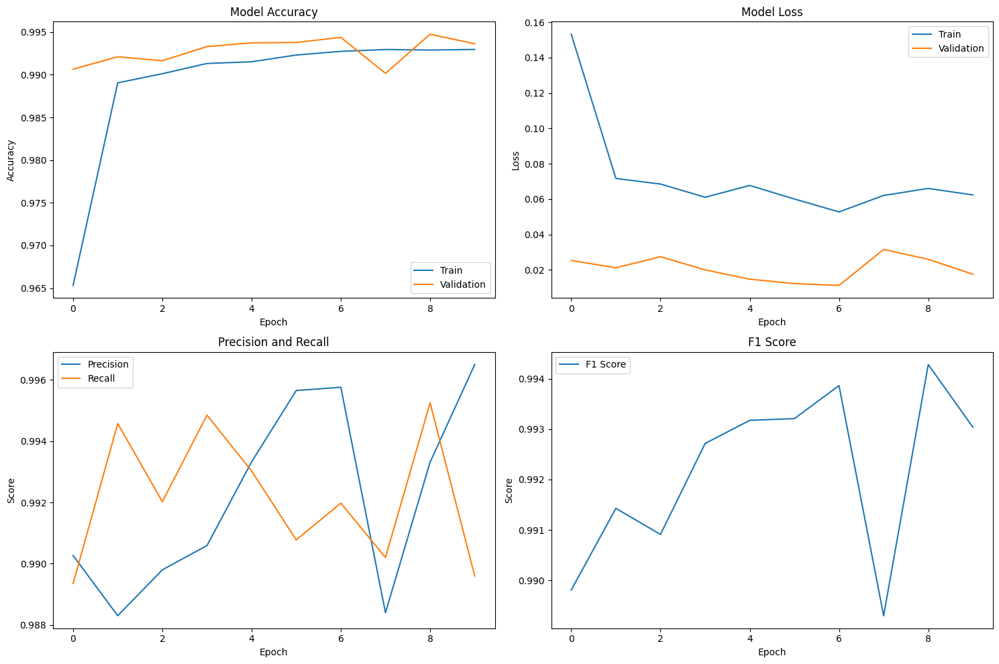

In [57]:
plot_training_history(history)


In [13]:
def test_model(model, test_loader, device):
    model.eval()
    all_outputs = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc='Testing'):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            all_outputs.extend(outputs.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    all_outputs = np.array(all_outputs) > 0.5
    all_labels = np.array(all_labels) > 0.5

    correct = np.sum(all_outputs == all_labels)
    accuracy = correct / len(all_labels)

    tp = np.sum((all_outputs == 1) & (all_labels == 1))
    fp = np.sum((all_outputs == 1) & (all_labels == 0))
    fn = np.sum((all_outputs == 0) & (all_labels == 1))
    tn = np.sum((all_outputs == 0) & (all_labels == 0))

    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0

    return {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'confusion_matrix': {'tp': int(tp), 'fp': int(fp), 'fn': int(fn), 'tn': int(tn)}
    }


In [65]:
# Ensure model is in evaluation mode
model.eval()

# Run the test set evaluation
test_metrics = test_model(model, test_loader, device)

# Display results
print("\n=== Test Set Evaluation ===")
print(f"Accuracy:  {test_metrics['accuracy']:.4f}")
print(f"Precision: {test_metrics['precision']:.4f}")
print(f"Recall:    {test_metrics['recall']:.4f}")
print(f"F1 Score:  {test_metrics['f1']:.4f}")
print("Confusion Matrix:", test_metrics['confusion_matrix'])


Testing: 100%|██████████| 2722/2722 [06:08<00:00,  7.39it/s]



=== Test Set Evaluation ===
Accuracy:  0.9937
Precision: 0.9969
Recall:    0.9895
F1 Score:  0.9932
Confusion Matrix: {'tp': 39579, 'fp': 124, 'fn': 421, 'tn': 46962}


In [14]:
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0]

        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_backward_hook(backward_hook)

    def generate(self, input_tensor, target_index=0):
        self.model.zero_grad()
        output = self.model(input_tensor)
        output[0, target_index].backward()

        weights = torch.mean(self.gradients, dim=(0, 2))
        cam = torch.zeros(self.activations.shape[2]).to(input_tensor.device)
        for i, w in enumerate(weights):
            cam += w * self.activations[0, i, :]

        cam = F.relu(cam)
        cam = cam.cpu().detach().numpy()
        cam -= cam.min()
        cam /= cam.max() if cam.max() > 0 else 1
        return cam


In [28]:
def visualize_gradcam(model, trace_name, hdf5_path, device, data_group=None):
    with h5py.File(hdf5_path, 'r') as f:
        waveform = np.array(f[data_group][trace_name] if data_group else f[trace_name])

   
    predictor = RealTimePredictor("earthquake_cnn_weights.pth", hdf5_path, device, data_group)
    predictor.model = model
    predictor.scalers = [StandardScaler() for _ in range(waveform.shape[1])]
    for c in range(waveform.shape[1]):
        predictor.scalers[c].fit(waveform[:, c].reshape(-1, 1))

    input_tensor = predictor.preprocess_waveform(waveform)
    grad_cam = GradCAM(model, model.conv4)
    heatmap = grad_cam.generate(input_tensor)

    with torch.no_grad():
        prob = model(input_tensor).item()

    plt.figure(figsize=(15, 10))
    for i in range(waveform.shape[1]):
        plt.subplot(4, 1, i + 1)
        plt.plot(waveform[:, i])
        plt.title(f"Component {i+1}")
    plt.subplot(4, 1, 4)
    plt.plot(heatmap)
    plt.title(f"Grad-CAM Heatmap — Predicted Probability: {prob:.4f}")
    plt.tight_layout()
    plt.show()


/home/anjali/Documents/meow/final_showdown/.venv/lib/python3.13/site-packages/torch/nn/modules/module.py:1830: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


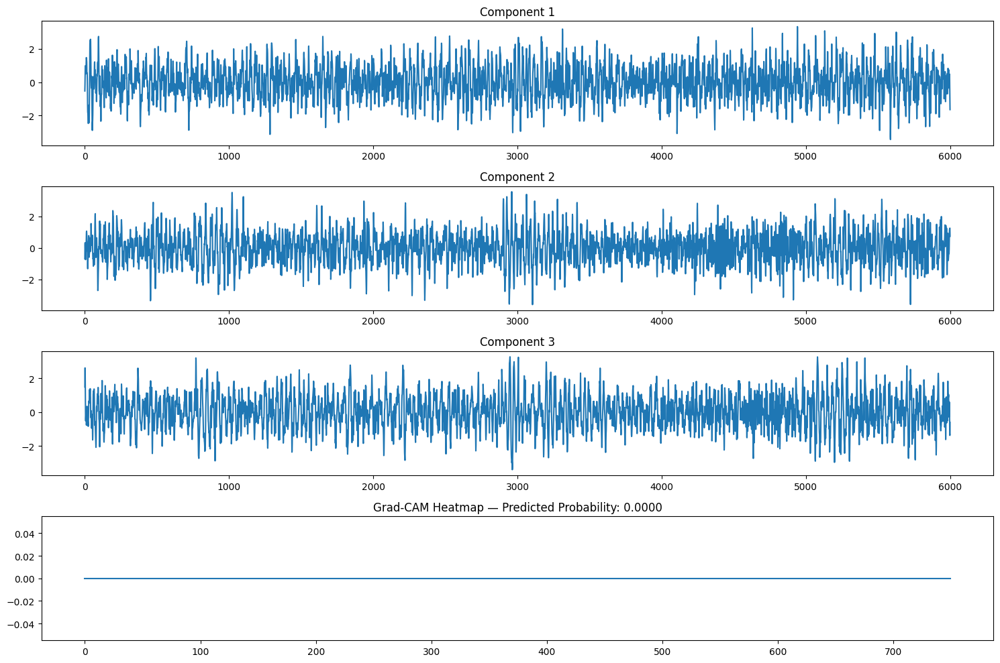

In [31]:
# Pick a trace name from test set
example_trace = metadata_df['trace_name'].iloc[test_idx[0]]
visualize_gradcam(model, example_trace, hdf5_path, device, data_group)


In [18]:
# Load metadata and prepare dataset
csv_path = "merged.csv"
hdf5_path = "merged.hdf5"
metadata_df, data_group, train_idx, val_idx, test_idx = load_and_prepare(csv_path, hdf5_path)


/tmp/ipykernel_946/3728508395.py:2: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata_df = pd.read_csv(csv_path)
/tmp/ipykernel_946/1140021148.py:67: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata_df = pd.read_csv(csv_path)


CSV loaded successfully with 435426 records
HDF5 file structure:
- data
  Subkeys (first 5): ['109C.TA_20060723155859_EV', '109C.TA_20061103155652_EV', '109C.TA_20061103161223_EV', '109C.TA_20061114133221_EV', '109C.TA_20061127104640_EV']
Sample trace names from metadata: ['109C.TA_20060723155859_EV' '109C.TA_20061103155652_EV'
 '109C.TA_20061103161223_EV' '109C.TA_20061114133221_EV'
 '109C.TA_20061127104640_EV']
Checking inside 'data' group...
Found trace: 109C.TA_20060723155859_EV in 'data' group
Training set size: 261255
Validation set size: 87085
Test set size: 87086


In [ ]:
# 1. Instantiate model architecture
model = EarthquakeCNN(input_channels=3).to(device)

# 2. Load state_dict (weights only)
state_dict = torch.load("earthquake_cnn_weights.pth", map_location=device)
model.load_state_dict(state_dict)

# 3. Set model to eval mode
model.eval()


In [33]:
class ContinuousEarthquakeMonitor:
    def __init__(self, model_path, device=None, buffer_size=6000):
        self.device = device or torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        self.model = EarthquakeCNN(input_channels=3).to(self.device)
        self.model.load_state_dict(torch.load(model_path, map_location=self.device))
        self.model.eval()

        self.buffer_size = buffer_size
        self.buffer = np.zeros((buffer_size, 3))
        self.buffer_idx = 0

        self.scalers = [StandardScaler() for _ in range(3)]
        self.scalers_fitted = False

        self.detection_threshold = 0.7
        self.cooldown_samples = buffer_size // 2
        self.cooldown_counter = 0
        self.detections = []

    def add_sample(self, sample):
        self.buffer[self.buffer_idx] = sample
        self.buffer_idx = (self.buffer_idx + 1) % self.buffer_size

        if not self.scalers_fitted:
            for c in range(3):
                self.scalers[c].partial_fit(sample[c].reshape(1, -1))

    def fit_scalers(self, calibration_data):
        for c in range(3):
            self.scalers[c].fit(calibration_data[:, c].reshape(-1, 1))
        self.scalers_fitted = True

    def process_buffer(self):
        if self.cooldown_counter > 0:
            self.cooldown_counter -= 1
            return {'probability': 0.0, 'detection': False, 'status': 'cooldown'}

        waveform = np.concatenate([self.buffer[self.buffer_idx:], self.buffer[:self.buffer_idx]])
        for c in range(3):
            waveform[:, c] = self.scalers[c].transform(waveform[:, c].reshape(-1, 1)).reshape(-1)

        tensor = torch.FloatTensor(waveform).unsqueeze(0).to(self.device)

        with torch.no_grad():
            probability = self.model(tensor).item()

        detection = probability >= self.detection_threshold
        if detection:
            self.cooldown_counter = self.cooldown_samples
            self.detections.append({'timestamp': time.time(), 'probability': probability})

        return {'probability': probability, 'detection': detection, 'status': 'active'}

    def simulate_stream(self, test_data, duration_seconds=30, update_interval=0.1):
        samples_per_second = 100
        total_samples = int(duration_seconds * samples_per_second)
        data_length = test_data.shape[0]

        plt.figure(figsize=(12, 8))
        plt.ion()
        time_array = np.arange(100) * update_interval
        prob_array = np.zeros(100)

        status_text = plt.text(0.5, 0.95, 'Monitoring...', transform=plt.gca().transAxes, fontsize=14, ha='center')
        line_prob, = plt.plot(time_array, prob_array, 'r-', label='Detection Probability')
        plt.axhline(y=self.detection_threshold, color='g', linestyle='--', label='Threshold')
        plt.title('Real-time Earthquake Detection')
        plt.xlabel('Time (s)')
        plt.ylabel('Detection Probability')
        plt.legend()
        plt.ylim(0, 1)

        for i in range(total_samples):
            idx = i % data_length
            sample = test_data[idx]
            self.add_sample(sample)

            if i % 10 == 0:
                result = self.process_buffer()
                prob_array = np.roll(prob_array, -1)
                prob_array[-1] = result['probability']

                if result['detection']:
                    status_text.set_text('EARTHQUAKE DETECTED!')
                    status_text.set_color('red')
                elif result['status'] == 'cooldown':
                    status_text.set_text('Cooldown period after detection')
                    status_text.set_color('orange')
                else:
                    status_text.set_text('Monitoring...')
                    status_text.set_color('green')

                line_prob.set_ydata(prob_array)
                plt.draw()
                plt.pause(0.001)

            time.sleep(update_interval / 10)

        plt.ioff()
        plt.show()
        print(f"Simulation complete. Detected {len(self.detections)} events.")


In [ ]:
!pip install joblib


In [ ]:
joblib.dump("earthquake_cnn_weights.pth","seismic_model.pkl")

In [48]:
import pandas as pd

metadata = pd.read_csv("merged.csv")


/tmp/ipykernel_946/81792649.py:3: DtypeWarning: Columns (7,11,13,14,24,25,26,30,31) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata = pd.read_csv("merged.csv")


In [49]:
sample = metadata.sample(1).iloc[0]
trace_name = sample['trace_name']


In [ ]:
import h5py
import numpy as np

def load_signal_from_trace(hdf5_path, trace_name):
    with h5py.File(hdf5_path, 'r') as f:
        trace_data = f[trace_name]['trace_data'][:]  
        return trace_data


In [ ]:
def predict_from_trace(model, signal):
    tensor_input = torch.tensor(signal, dtype=torch.float32).unsqueeze(0)  
    with torch.no_grad():
        output = model(tensor_input)
    return output.item()


In [ ]:
def check_trace_names_in_hdf5(hdf5_path):
    with h5py.File(hdf5_path, 'r') as f:
        available_traces = list(f.keys())  
    return available_traces
